In [1]:
import pandas as pd
import pandas_profiling
import numpy as np

In [2]:
df = pd.read_csv('allgames_stats.csv')
df.describe()

,G,GS,FG,FGA,FG%,3P,3PA,3P%,FT,FTA,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,GmSc
count,4254.000000,4254.000000,4250.000000,4247.000000,4237.000000,4254.000000,4254.000000,3750.000000,4253.000000,4252.000000,...,4253.000000,4252.000000,4254.000000,4254.000000,4243.000000,4253.000000,4254.000000,4254.000000,4245.000000,4035.000000
mean,33.771039,0.952515,9.956000,20.701907,0.478806,1.162435,3.478138,0.298587,6.402304,7.998589,...,1.293910,5.044450,6.345087,5.724024,1.745934,0.701152,3.092619,2.377292,27.444287,20.548178
std,23.250115,0.212698,3.801338,6.387853,0.121048,1.371055,2.670980,0.276708,3.894380,4.524951,...,1.277438,2.742909,3.127640,3.019336,1.402170,0.916192,1.859863,1.412670,9.671222,8.789507
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-5.900000
25%,13.000000,1.000000,7.000000,17.000000,0.400000,0.000000,1.000000,0.000000,4.000000,5.000000,...,0.000000,3.000000,4.000000,4.000000,1.000000,0.000000,2.000000,1.000000,21.000000,14.600000
50%,31.000000,1.000000,10.000000,21.000000,0.480000,1.000000,3.000000,0.290000,6.000000,8.000000,...,1.000000,5.000000,6.000000,5.000000,2.000000,0.000000,3.000000,2.000000,27.000000,20.900000
75%,53.000000,1.000000,12.000000,25.000000,0.560000,2.000000,5.000000,0.500000,9.000000,11.000000,...,2.000000,7.000000,8.000000,8.000000,3.000000,1.000000,4.000000,3.000000,34.000000,26.400000
max,82.000000,1.000000,28.000000,50.000000,1.000000,12.000000,21.000000,1.000000,24.000000,28.000000,...,9.000000,17.000000,19.000000,19.000000,7.000000,5.000000,11.000000,6.000000,81.000000,63.500000


In [3]:
df.shape

(4254, 29)

### Предварительный анализ выборки

In [4]:
pandas_profiling.ProfileReport(df)

<p> Из предварительного анализа выборки видно что некоторые переменные имеют парную корреляцию из за связности параметров, например кол-во бросков и процентное соотношение попаданий. Это не должно повлиять на итоговую оценку если одна из этих переменных не будет выбрана в качестве целевой.</p>

<p> Такие переменные как Date и MP имеют высокую мощность множества из за большого числа строковых значений даты и времени. Их необходимо привести к числовому виду- времени в секундах. Также видно что переменная Date имеет равномерно распределние </p>

<p> Переменная X имеет 50% пропущенных значений, но это не упущение. Данное поле классифицируется как хозяин/гость. Остальные переменные имеют небольшой процент пропущенных значений. Они будут замещены нулевыми значениями. </p>

<p> Некоторые переменные имеют нулевые значения, но это не факт того что значения пропущены. Например, для переменной 3P это значит что игрок забил 0 раз 3-очковый бросок. </p>

### Предварительная обработка данных

In [5]:
# Предобработка игроков
player_map = {
    'Kobe Bryant': 0,
    'Lebron James': 1,
    'Michael Jordan': 2
}
df['Player'] = df['Player'].map(player_map)
df['Player'] = df.reindex(columns=['Player'])

result_index = df.columns.get_loc("Result")

# Конвертация уникальных строковых значений в числовые индексы
def map_series(s):
    return {item[1]: item[0] for item in s.items()}

# Предобработка команды противника
opps = df['Opp'].unique()
s = pd.Series(opps)
df['Opp'] = df['Opp'].map(map_series(s))

# Предобработка результата (W/L)
results = df['Result'].unique()
s = pd.Series(results)
map_results = map_series(s)
df['Result'] = df['Result'].map(map_results)

import datetime
import time

# Конвертация даты в timestamp
def map_date(date):
    x = time.strptime(date, '%Y-%m-%d')
    dt = datetime.datetime.fromtimestamp(time.mktime(x))
    return dt.timestamp()

# Конвертация времени игры в timestamp
def map_time(time_str):
    x = time.strptime(time_str,'%M:%S')
    return datetime.timedelta(minutes=x.tm_min,seconds=x.tm_sec).total_seconds()

# Преодбработка даты игры и времени игрока
df['Date'] = df['Date'].map(map_date)
df['MP'] = df['MP'].map(map_time)

# Преобработка команд
teams = df['Tm'].unique()
s = pd.Series(teams)
df['Tm'] = df['Tm'].map(map_series(s))

# Преобработка сезонов
seasons_map = {
    'Regular Season': 0,
    'Playoffs': 1
}
df['RSorPO'] = df['RSorPO'].map(seasons_map)
season_index = df.columns.get_loc("RSorPO")
if result_index < season_index:
    season_index -= 1

# Предобработка гость/хозяин
visitor_map = {
    '@': 1
}
df['X'] = df['X'].map(visitor_map)

gs_index = df.columns.get_loc("GmSc")
if result_index < gs_index:
    gs_index -= 1

# Предобработка пропущенных значений
df['3P%'] = df['3P%'].interpolate(method='polynomial', order=2)
df['FT%'] = df['FT%'].interpolate(method='polynomial', order=2)
df['GmSc'] = df['GmSc'].interpolate(method='polynomial', order=2)
df = df.fillna(value={'X': 0})

df.dropna(inplace=True)

min_values = df.min()
print('Min value in each column : ')
print(min_values)

max_values = df.max()
print('Max value in each column : ')
print(max_values)

df.describe()

Min value in each column : 
G         1.000000e+00
Date      4.675716e+08
Tm        0.000000e+00
X         0.000000e+00
Opp       0.000000e+00
Result    0.000000e+00
GS        0.000000e+00
MP        6.000000e+01
FG        0.000000e+00
FGA       1.000000e+00
FG%       0.000000e+00
3P        0.000000e+00
3PA       0.000000e+00
3P%      -1.246581e+00
FT        0.000000e+00
FTA       0.000000e+00
FT%      -1.277599e-01
ORB       0.000000e+00
DRB       0.000000e+00
TRB       0.000000e+00
AST       0.000000e+00
STL       0.000000e+00
BLK       0.000000e+00
TOV       0.000000e+00
PF        0.000000e+00
PTS       0.000000e+00
GmSc     -5.900000e+00
Player    0.000000e+00
RSorPO    0.000000e+00
dtype: float64
Max value in each column : 
G         8.200000e+01
Date      1.553792e+09
Tm        4.000000e+00
X         1.000000e+00
Opp       3.800000e+01
Result    1.000000e+00
GS        1.000000e+00
MP        3.360000e+03
FG        2.800000e+01
FGA       5.000000e+01
FG%       1.000000e+00
3P       

,G,Date,Tm,X,Opp,Result,GS,MP,FG,FGA,...,TRB,AST,STL,BLK,TOV,PF,PTS,GmSc,Player,RSorPO
count,4211.000000,4.211000e+03,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,...,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000
mean,33.800760,1.076901e+09,1.322489,0.498219,15.260033,0.355498,0.953930,2287.408217,9.937070,20.701971,...,6.341962,5.736405,1.746616,0.697459,3.098789,2.377108,27.426027,20.635226,0.921159,0.148183
std,23.215595,2.835302e+08,1.304301,0.500056,9.552558,0.478721,0.209661,401.618321,3.741668,6.295626,...,3.101359,3.012145,1.401106,0.913681,1.857955,1.410105,9.550960,8.716426,0.809067,0.355324
min,1.000000,4.675716e+08,0.000000,0.000000,0.000000,0.000000,0.000000,60.000000,0.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-5.900000,0.000000,0.000000
25%,13.000000,8.721810e+08,0.000000,0.000000,7.000000,0.000000,1.000000,2100.000000,7.000000,17.000000,...,4.000000,4.000000,1.000000,0.000000,2.000000,1.000000,21.000000,14.800000,0.000000,0.000000
50%,31.000000,1.112720e+09,1.000000,0.000000,14.000000,0.000000,1.000000,2340.000000,10.000000,21.000000,...,6.000000,5.000000,2.000000,0.000000,3.000000,2.000000,27.000000,20.900000,1.000000,0.000000
75%,53.000000,1.297577e+09,3.000000,1.000000,24.000000,1.000000,1.000000,2545.500000,12.000000,25.000000,...,8.000000,8.000000,3.000000,1.000000,4.000000,3.000000,33.000000,26.400000,2.000000,0.000000
max,82.000000,1.553792e+09,4.000000,1.000000,38.000000,1.000000,1.000000,3360.000000,28.000000,50.000000,...,19.000000,19.000000,7.000000,5.000000,11.000000,6.000000,81.000000,63.500000,2.000000,1.000000


In [6]:
df.shape

(4211, 29)

### Выбор необходимых для анализа переменных

In [7]:
X=df.drop(['Result'], axis = 1)

В качесте X переменных выбраны все переменные, которые не имеют большого влияния на целевую переменную. GmSc также не имеет большого влияния, так как кол-во очков не сильно влияет на выигрыш, так как команда противника могла набрать их больше.

In [8]:
X.describe()

,G,Date,Tm,X,Opp,GS,MP,FG,FGA,FG%,...,TRB,AST,STL,BLK,TOV,PF,PTS,GmSc,Player,RSorPO
count,4211.000000,4.211000e+03,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,...,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000,4211.000000
mean,33.800760,1.076901e+09,1.322489,0.498219,15.260033,0.953930,2287.408217,9.937070,20.701971,0.478559,...,6.341962,5.736405,1.746616,0.697459,3.098789,2.377108,27.426027,20.635226,0.921159,0.148183
std,23.215595,2.835302e+08,1.304301,0.500056,9.552558,0.209661,401.618321,3.741668,6.295626,0.120500,...,3.101359,3.012145,1.401106,0.913681,1.857955,1.410105,9.550960,8.716426,0.809067,0.355324
min,1.000000,4.675716e+08,0.000000,0.000000,0.000000,0.000000,60.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-5.900000,0.000000,0.000000
25%,13.000000,8.721810e+08,0.000000,0.000000,7.000000,1.000000,2100.000000,7.000000,17.000000,0.400000,...,4.000000,4.000000,1.000000,0.000000,2.000000,1.000000,21.000000,14.800000,0.000000,0.000000
50%,31.000000,1.112720e+09,1.000000,0.000000,14.000000,1.000000,2340.000000,10.000000,21.000000,0.480000,...,6.000000,5.000000,2.000000,0.000000,3.000000,2.000000,27.000000,20.900000,1.000000,0.000000
75%,53.000000,1.297577e+09,3.000000,1.000000,24.000000,1.000000,2545.500000,12.000000,25.000000,0.560000,...,8.000000,8.000000,3.000000,1.000000,4.000000,3.000000,33.000000,26.400000,2.000000,0.000000
max,82.000000,1.553792e+09,4.000000,1.000000,38.000000,1.000000,3360.000000,28.000000,50.000000,1.000000,...,19.000000,19.000000,7.000000,5.000000,11.000000,6.000000,81.000000,63.500000,2.000000,1.000000


###  Выбор целевой переменной

In [9]:
y=df['Result']

### Конечной целью для интеллектуального анализа данных является классификация побед/проигрышей.


### Деление выборки на тренировочную и тестовую

In [10]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=21)

#### Стандартизация данных

In [11]:
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
X_train=sc_X.fit_transform(X_train)
X_test=sc_X.transform(X_test)

### Тренировка и оценивание модели

In [12]:
from sklearn.metrics import r2_score

def train_validate_score(model):
    kfold = StratifiedKFold(n_splits=10,
                            random_state=1).split(X_train, y_train)

    for k, (train, test) in enumerate(kfold):
        model.fit(X_train[train], y_train.iloc[train])
        print('Fold: %s, Class dist.: %s' % (k+1,
              np.bincount(y_train.iloc[train])))

    y_pred=model.predict(X_test)
    print('\nAccuracy: %.2f' % accuracy_score(y_test, y_pred))
    print('\nRecall: %s' % recall_score(y_test, y_pred, average = None))
    print('\nPrecision: %s' % precision_score(y_test, y_pred, average = None))

### Матрица ошибок

In [13]:
def confusion_matrix(model, clf_name):
    fig=plot_confusion_matrix(model, X_test, y_test, display_labels = map_results)
    fig.figure_.suptitle("Confusion Matrix for %s" % clf_name)
    plt.show()

### MLP Classifier

In [14]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, recall_score, precision_score
from sklearn.metrics import plot_confusion_matrix, classification_report
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedKFold, GridSearchCV

clf = MLPClassifier(random_state=1)
hildden_layer_sizes = [(256,128,64,32)]

param_grid = {'hidden_layer_sizes': hildden_layer_sizes, 
               'activation': ['identity', 'relu'],
               'solver': ['lbfgs', 'adam']}
gs = GridSearchCV(estimator=clf,
                  param_grid=param_grid,
                  scoring='accuracy',
                  cv=2)
gs = gs.fit(X_train, y_train)

train_validate_score(gs.best_estimator_)

/Users/victor/.local/share/virtualenvs/Jupyter_labs-JXG9xq5b/lib/python3.8/site-packages/sklearn/model_selection/_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


Fold: 1, Class dist.: [1699  953]
Fold: 2, Class dist.: [1699  953]
Fold: 3, Class dist.: [1699  953]
Fold: 4, Class dist.: [1699  953]
Fold: 5, Class dist.: [1699  953]
Fold: 6, Class dist.: [1699  953]
Fold: 7, Class dist.: [1699  953]
Fold: 8, Class dist.: [1700  953]
Fold: 9, Class dist.: [1700  953]
Fold: 10, Class dist.: [1699  954]

Accuracy: 0.72

Recall: [0.83535109 0.50913242]

Precision: [0.76243094 0.62116992]


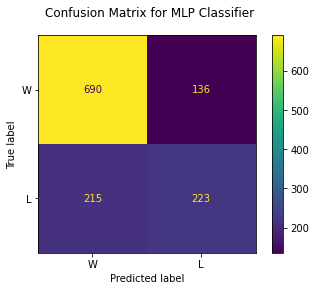

In [15]:
clf = gs.best_estimator_
confusion_matrix(clf, "MLP Classifier")

### Random Forest Classifier

In [16]:
from sklearn.ensemble import RandomForestClassifier

forest_model = RandomForestClassifier(random_state=1,n_jobs=-1)

n_estimators = [10, 20, 30, 40]
max_depths = [10, 20, 30]
param_grid = {'criterion': ["entropy", "gini"], 
               'n_estimators': n_estimators,
               'max_depth': max_depths}
gs = GridSearchCV(estimator=forest_model,
                  param_grid=param_grid,
                  scoring='accuracy',
                  cv=2)
gs = gs.fit(X_train, y_train)
forest_model = gs.best_estimator_

train_validate_score(forest_model)

/Users/victor/.local/share/virtualenvs/Jupyter_labs-JXG9xq5b/lib/python3.8/site-packages/sklearn/model_selection/_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


Fold: 1, Class dist.: [1699  953]
Fold: 2, Class dist.: [1699  953]
Fold: 3, Class dist.: [1699  953]
Fold: 4, Class dist.: [1699  953]
Fold: 5, Class dist.: [1699  953]
Fold: 6, Class dist.: [1699  953]
Fold: 7, Class dist.: [1699  953]
Fold: 8, Class dist.: [1700  953]
Fold: 9, Class dist.: [1700  953]
Fold: 10, Class dist.: [1699  954]

Accuracy: 0.72

Recall: [0.88256659 0.41552511]

Precision: [0.74010152 0.65232975]


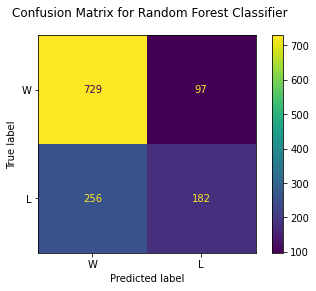

In [17]:

confusion_matrix(forest_model, "Random Forest Classifier")

### Gradient Boosting Classifier

In [18]:
from sklearn.ensemble import GradientBoostingClassifier

g_boost = GradientBoostingClassifier(n_estimators=20, learning_rate=0.4,
                                    max_depth=5, random_state=1)
n_estimators = [10, 20, 30]
learning_rates = [0.1, 0.4, 0.6]
criterions = ["friedman_mse", "mse", "mae"]
param_grid = { 'loss': ["deviance"], 
               'n_estimators': n_estimators,
               'learning_rate': learning_rates,
              'criterion': criterions }
gs = GridSearchCV(estimator=g_boost,
                  param_grid=param_grid,
                  scoring='accuracy',
                  cv=2)
gs = gs.fit(X_train, y_train)
g_boost = gs.best_estimator_

train_validate_score(g_boost)

/Users/victor/.local/share/virtualenvs/Jupyter_labs-JXG9xq5b/lib/python3.8/site-packages/sklearn/model_selection/_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


Fold: 1, Class dist.: [1699  953]
Fold: 2, Class dist.: [1699  953]
Fold: 3, Class dist.: [1699  953]
Fold: 4, Class dist.: [1699  953]
Fold: 5, Class dist.: [1699  953]
Fold: 6, Class dist.: [1699  953]
Fold: 7, Class dist.: [1699  953]
Fold: 8, Class dist.: [1700  953]
Fold: 9, Class dist.: [1700  953]
Fold: 10, Class dist.: [1699  954]

Accuracy: 0.72

Recall: [0.8716707  0.43607306]

Precision: [0.74457084 0.64309764]


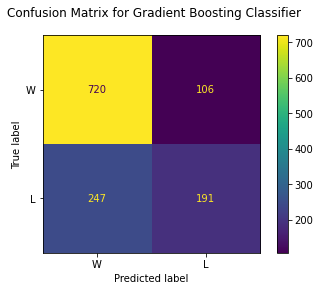

In [19]:
confusion_matrix(g_boost, "Gradient Boosting Classifier")

### Logistic regression

In [20]:
from sklearn.linear_model import LogisticRegression

reg = LogisticRegression(random_state=0)
c = [0.01, 0.1, 10, 50]


param_grid = param_grid = [{ 'penalty': ['l2'], 
                             'c': c,
                             'solver': ["newton-cg", "lbfgs", "sag", "saga"]},
                           {'penalty': ['l1'], 
                             'c': c,
                             'solver': ["liblinear", "saga"]}]
reg = gs.best_estimator_
train_validate_score(reg)

/Users/victor/.local/share/virtualenvs/Jupyter_labs-JXG9xq5b/lib/python3.8/site-packages/sklearn/model_selection/_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


Fold: 1, Class dist.: [1699  953]
Fold: 2, Class dist.: [1699  953]
Fold: 3, Class dist.: [1699  953]
Fold: 4, Class dist.: [1699  953]
Fold: 5, Class dist.: [1699  953]
Fold: 6, Class dist.: [1699  953]
Fold: 7, Class dist.: [1699  953]
Fold: 8, Class dist.: [1700  953]
Fold: 9, Class dist.: [1700  953]
Fold: 10, Class dist.: [1699  954]

Accuracy: 0.72

Recall: [0.8716707  0.43607306]

Precision: [0.74457084 0.64309764]


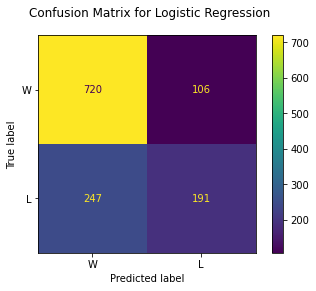

In [21]:
confusion_matrix(reg, "Logistic Regression")

### Важности признаков

In [22]:
feat_labels = df.columns[1:]
importances = forest_model.feature_importances_
indices = np.argsort(importances)[::-1]

for f in range(X_train .shape[1]):
    print("%2d ) %-*s %f " % (f + 1 , 30 , feat_labels[indices[f]] , importances[indices[f]]))

 1 ) GmSc                           0.106439 
 2 ) FG%                            0.083724 
 3 ) Tm                             0.077360 
 4 ) MP                             0.065802 
 5 ) Opp                            0.054626 
 6 ) FGA                            0.051758 
 7 ) 3PA                            0.044706 
 8 ) Date                           0.042226 
 9 ) TOV                            0.037272 
10 ) 3P%                            0.037269 
11 ) Result                         0.036910 
12 ) PTS                            0.035918 
13 ) AST                            0.033485 
14 ) FT%                            0.033143 
15 ) TRB                            0.030421 
16 ) FTA                            0.028054 
17 ) PF                             0.027446 
18 ) FT                             0.026415 
19 ) DRB                            0.025779 
20 ) FG                             0.025758 
21 ) STL                            0.021743 
22 ) 3P                           

### По результатам тренировки и тестирования моделей можно сделать вывод что они все имеют практически одинаковую оценку точности, но имеют неккоторые отличие в реализации классификации и в матрице ошибок. R2 Оценка всех моделей около 0.72, что говорит о том что модель не совсем плоха, но имеет некоторые ошибки при классификации победы/поражений на основе различных критериев.